In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import datetime
import os
from scipy.spatial import distance_matrix

# Loading up the network

In [2]:
#getting the set of edges which describe the network
edges = pd.read_csv('mny.rnet',
                    sep=' ',
                    names=['ID_edge',
                          'from_ID',
                          'to_ID',
                          'from_x',
                          'from_y',
                          'to_x',
                          'to_y'])
edges

,ID_edge,from_ID,to_ID,from_x,from_y,to_x,to_y
0,0,1,2,-73.978969,40.783390,-73.979568,40.783650
1,1,2,1,-73.979568,40.783650,-73.978969,40.783390
2,2,3,4,-73.991688,40.738045,-73.991019,40.737764
3,3,4,3,-73.991019,40.737764,-73.991688,40.738045
4,4,5,6,-73.931611,40.800105,-73.931214,40.799478
...,...,...,...,...,...,...,...
31439,31439,12087,5826,-74.002284,40.743017,-74.001587,40.742735
31440,31440,1407,12318,-73.974540,40.746211,-73.973978,40.746062
31441,31441,12318,1407,-73.973978,40.746062,-73.974540,40.746211
31442,31442,12060,11570,-73.936115,40.797205,-73.935504,40.796956


In [3]:
nodes_from=edges[['from_ID','from_x','from_y']]
nodes_from.columns=['id','x','y']
nodes_from

,id,x,y
0,1,-73.978969,40.783390
1,2,-73.979568,40.783650
2,3,-73.991688,40.738045
3,4,-73.991019,40.737764
4,5,-73.931611,40.800105
...,...,...,...
31439,12087,-74.002284,40.743017
31440,1407,-73.974540,40.746211
31441,12318,-73.973978,40.746062
31442,12060,-73.936115,40.797205


In [4]:
nodes_to=edges[['to_ID','to_x','to_y']]
nodes_to.columns=['id','x','y']
nodes_to

,id,x,y
0,2,-73.979568,40.783650
1,1,-73.978969,40.783390
2,4,-73.991019,40.737764
3,3,-73.991688,40.738045
4,6,-73.931214,40.799478
...,...,...,...
31439,5826,-74.001587,40.742735
31440,12318,-73.973978,40.746062
31441,1407,-73.974540,40.746211
31442,11570,-73.935504,40.796956


In [5]:
nodes=pd.concat([nodes_from,nodes_to],ignore_index=True)
nodes

,id,x,y
0,1,-73.978969,40.783390
1,2,-73.979568,40.783650
2,3,-73.991688,40.738045
3,4,-73.991019,40.737764
4,5,-73.931611,40.800105
...,...,...,...
62883,5826,-74.001587,40.742735
62884,12318,-73.973978,40.746062
62885,1407,-73.974540,40.746211
62886,11570,-73.935504,40.796956


In [6]:
print("Min and Max node ID")
print(min(nodes['id']))
print(max(nodes['id']))

Min and Max node ID
1
12320


In [7]:
#filter out duplicates (i.e where the ID, x and y coord are all the same)
nodes=nodes.drop_duplicates(subset=['id','x','y'])
nodes.set_index('id',inplace=True)
nodes

,x,y
id,,
1,-73.978969,40.783390
2,-73.979568,40.783650
3,-73.991688,40.738045
4,-73.991019,40.737764
5,-73.931611,40.800105
...,...,...
12316,-73.986592,40.773109
12317,-73.913304,40.876437
12318,-73.973978,40.746062


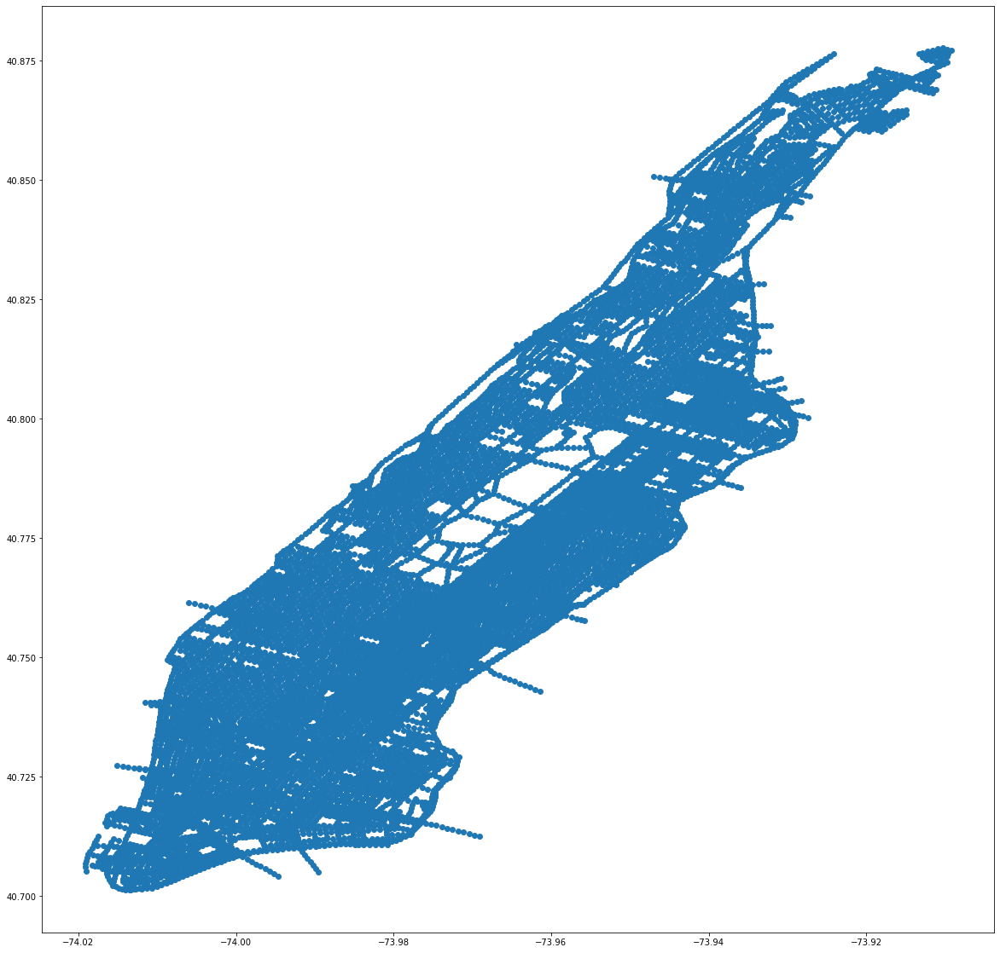

In [8]:
plt.figure(figsize=(20,20))
plt.scatter(nodes.x,nodes.y)
plt.show()

# Extracting the vaild requests

In [9]:
raw = pd.read_csv('./yellow_tripdata_2013-05.csv')
raw

,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,rate_code,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,payment_type,fare_amount,surcharge,mta_tax,tip_amount,tolls_amount,total_amount
0,VTS,2013-05-01 00:04:00,2013-05-01 00:12:00,1,1.34,-73.982287,40.772815,1,NaN,-73.986210,40.758742,CSH,7.0,0.5,0.5,0.0,0.00,8.00
1,VTS,2013-05-01 00:03:00,2013-05-01 00:10:00,5,2.60,-73.963010,40.711900,1,NaN,-73.991875,40.721917,CRD,9.5,0.5,0.5,2.0,0.00,12.50
2,VTS,2013-05-01 00:04:00,2013-05-01 00:10:00,2,1.31,-73.981780,40.724352,1,NaN,-73.973755,40.736892,CRD,6.5,0.5,0.5,1.0,0.00,8.50
3,VTS,2013-05-01 00:05:00,2013-05-01 00:09:00,1,0.82,-73.964017,40.709692,1,NaN,-73.950895,40.710972,CSH,5.5,0.5,0.5,0.0,0.00,6.50
4,VTS,2013-05-01 00:05:00,2013-05-01 00:14:00,1,1.65,-73.973917,40.752787,1,NaN,-73.996203,40.755867,CRD,8.5,0.5,0.5,1.8,0.00,11.30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15285044,VTS,2013-05-05 13:18:00,2013-05-05 13:23:00,1,0.81,-74.009787,40.725822,1,NaN,-73.998197,40.725125,CSH,5.5,0.0,0.5,0.0,0.00,6.00
15285045,VTS,2013-05-05 12:50:00,2013-05-05 13:25:00,5,13.34,-73.973995,40.742452,1,NaN,-73.922498,40.879372,CRD,41.5,0.0,0.5,8.3,4.88,55.18
15285046,VTS,2013-05-05 13:11:00,2013-05-05 13:22:00,1,0.84,-73.964297,40.770562,1,NaN,-73.963378,40.761927,CSH,8.5,0.0,0.5,0.0,0.00,9.00
15285047,VTS,2013-05-05 11:33:00,2013-05-05 11:35:00,1,0.73,-73.988800,40.729947,1,NaN,-73.985800,40.738190,CSH,4.5,0.0,0.5,0.0,0.00,5.00


In [10]:
requests = raw[['pickup_datetime','passenger_count',
                'pickup_longitude','pickup_latitude',
                'dropoff_longitude','dropoff_latitude']]
requests

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,2013-05-01 00:04:00,1,-73.982287,40.772815,-73.986210,40.758742
1,2013-05-01 00:03:00,5,-73.963010,40.711900,-73.991875,40.721917
2,2013-05-01 00:04:00,2,-73.981780,40.724352,-73.973755,40.736892
3,2013-05-01 00:05:00,1,-73.964017,40.709692,-73.950895,40.710972
4,2013-05-01 00:05:00,1,-73.973917,40.752787,-73.996203,40.755867
...,...,...,...,...,...,...
15285044,2013-05-05 13:18:00,1,-74.009787,40.725822,-73.998197,40.725125
15285045,2013-05-05 12:50:00,5,-73.973995,40.742452,-73.922498,40.879372
15285046,2013-05-05 13:11:00,1,-73.964297,40.770562,-73.963378,40.761927
15285047,2013-05-05 11:33:00,1,-73.988800,40.729947,-73.985800,40.738190


In [11]:
#drop all requests with a quantity of 0
requests = requests[requests.passenger_count!=0]
requests

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,2013-05-01 00:04:00,1,-73.982287,40.772815,-73.986210,40.758742
1,2013-05-01 00:03:00,5,-73.963010,40.711900,-73.991875,40.721917
2,2013-05-01 00:04:00,2,-73.981780,40.724352,-73.973755,40.736892
3,2013-05-01 00:05:00,1,-73.964017,40.709692,-73.950895,40.710972
4,2013-05-01 00:05:00,1,-73.973917,40.752787,-73.996203,40.755867
...,...,...,...,...,...,...
15285044,2013-05-05 13:18:00,1,-74.009787,40.725822,-73.998197,40.725125
15285045,2013-05-05 12:50:00,5,-73.973995,40.742452,-73.922498,40.879372
15285046,2013-05-05 13:11:00,1,-73.964297,40.770562,-73.963378,40.761927
15285047,2013-05-05 11:33:00,1,-73.988800,40.729947,-73.985800,40.738190


In [12]:
requests['pickup_datetime']=pd.to_datetime(requests['pickup_datetime'])
requests.dtypes

pickup_datetime      datetime64[ns]
passenger_count               int64
pickup_longitude            float64
pickup_latitude             float64
dropoff_longitude           float64
dropoff_latitude            float64
dtype: object

In [13]:
start_date=datetime.datetime(year=2013,month=5,day=5,hour=0,minute=0)
#end_date=datetime.datetime(year=2013,month=5,day=5,hour=5,minute=0)
end_date=datetime.datetime(year=2013,month=5,day=11,hour=23,minute=59)

requests=requests[(requests['pickup_datetime']>=start_date)
         & (requests['pickup_datetime']<=end_date)]
requests

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
41,2013-05-05 12:32:00,1,-73.953742,40.775377,-73.958020,40.769212
42,2013-05-05 12:25:00,3,-73.977162,40.792962,-73.989507,40.776632
43,2013-05-05 12:22:00,4,-74.008442,40.744897,-74.013100,40.716730
44,2013-05-05 12:16:00,6,-74.007535,40.733105,-73.981365,40.767167
45,2013-05-05 11:55:00,1,-73.783890,40.646375,-74.014117,40.709700
...,...,...,...,...,...,...
15285044,2013-05-05 13:18:00,1,-74.009787,40.725822,-73.998197,40.725125
15285045,2013-05-05 12:50:00,5,-73.973995,40.742452,-73.922498,40.879372
15285046,2013-05-05 13:11:00,1,-73.964297,40.770562,-73.963378,40.761927
15285047,2013-05-05 11:33:00,1,-73.988800,40.729947,-73.985800,40.738190


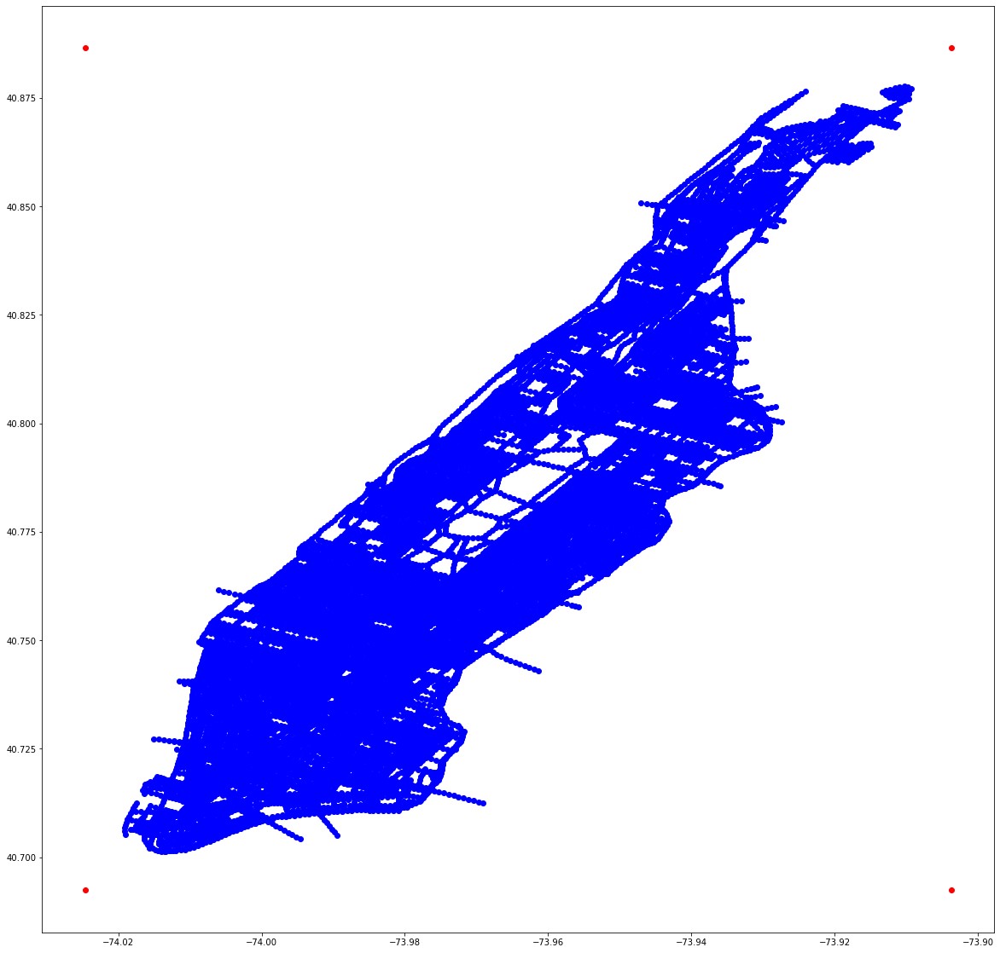

In [14]:
#creating a bounding box around the area of Manhattan, outside of which requests will be considered invalid
west = min(nodes['x'])
east = max(nodes['x'])
width = east-west
south = min(nodes['y'])
north = max(nodes['y'])
height = north-south
margin = 0.05 #we allow for a minor margin of error
west -= (margin*width)
east += (margin*width)
south -= (margin*height)
north += (margin*height)
topleft = (west,north)
topright = (east,north)
bottomleft = (west,south)
bottomright = (east,south)
corners = np.array([topleft,topright,bottomleft,bottomright])

#plotting the nodes in blue, and the limits in red
plt.figure(figsize=(20,20))
plt.scatter(nodes.x,nodes.y,c='b')
plt.scatter(corners[:,0],corners[:,1],c='r')
plt.show()

In [15]:
#dropping requests with an invalid longitude value
requests = requests[ (requests.pickup_longitude>=west)
            & (requests.dropoff_longitude>=west)
            & (requests.pickup_longitude<=east)
            & (requests.dropoff_longitude<=east) ]
#dropping reuqests with an invalid latitude value
requests = requests[ (requests.pickup_latitude>=south)
            & (requests.dropoff_latitude>=south)
            & (requests.pickup_latitude<=north)
            & (requests.dropoff_latitude<=north) ]
requests

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
41,2013-05-05 12:32:00,1,-73.953742,40.775377,-73.958020,40.769212
42,2013-05-05 12:25:00,3,-73.977162,40.792962,-73.989507,40.776632
43,2013-05-05 12:22:00,4,-74.008442,40.744897,-74.013100,40.716730
44,2013-05-05 12:16:00,6,-74.007535,40.733105,-73.981365,40.767167
46,2013-05-05 12:27:00,1,-73.991280,40.729855,-73.975487,40.752055
...,...,...,...,...,...,...
15285044,2013-05-05 13:18:00,1,-74.009787,40.725822,-73.998197,40.725125
15285045,2013-05-05 12:50:00,5,-73.973995,40.742452,-73.922498,40.879372
15285046,2013-05-05 13:11:00,1,-73.964297,40.770562,-73.963378,40.761927
15285047,2013-05-05 11:33:00,1,-73.988800,40.729947,-73.985800,40.738190


In [16]:
requests = requests.sort_values(by='pickup_datetime')
requests.reset_index(drop=True,inplace=True)
requests.index.name='rid'
requests

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
rid,,,,,,
0,2013-05-05 00:00:00,1,-73.992220,40.743887,-73.980035,40.753897
1,2013-05-05 00:00:00,1,-74.004365,40.742387,-73.977507,40.738262
2,2013-05-05 00:00:00,5,-74.007997,40.722702,-73.955172,40.774475
3,2013-05-05 00:00:00,2,-73.989092,40.723032,-73.951757,40.711697
4,2013-05-05 00:00:00,1,-73.975752,40.759510,-73.966092,40.770500
...,...,...,...,...,...,...
3131456,2013-05-11 23:59:00,1,-73.992552,40.758712,-73.997855,40.720647
3131457,2013-05-11 23:59:00,3,-73.974337,40.763037,-73.984418,40.743147
3131458,2013-05-11 23:59:00,1,-73.982965,40.738797,-73.955735,40.776142


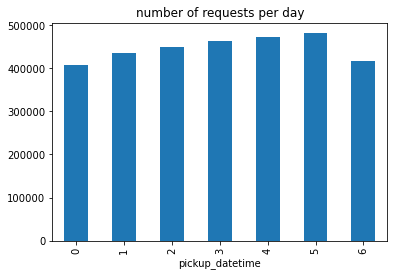

In [17]:
requests["pickup_datetime"].groupby(requests["pickup_datetime"].dt.dayofweek).count().plot(kind="bar")
plt.title('number of requests per day')
plt.show()

# Splitting up dataset into multiple files

In [18]:
data_dir="./filtered_longlat"
if not os.path.exists(data_dir):
    os.makedirs(data_dir)


for day in range(min(requests["pickup_datetime"].dt.day),max(requests["pickup_datetime"].dt.day)+1):
    day_df = requests[requests["pickup_datetime"].dt.day==day]
    print("day %d : %d requests"%(day,len(day_df)))
    for hour in range(min(day_df["pickup_datetime"].dt.hour),max(day_df["pickup_datetime"].dt.hour)+1):
            hour_df = day_df[day_df["pickup_datetime"].dt.hour==hour]
            hour_df = hour_df.sort_values(by='rid')
            filepath="%s/may%d_hour%d.csv"%(data_dir,day,hour)
            print("\t\thour %d : %d requests ... saving to file %s"%(hour,len(hour_df),filepath))
            hour_df.to_csv(filepath)


    

day 5 : 416709 requests
		hour 0 : 28715 requests ... saving to file ./filtered_longlat/may5_hour0.csv
		hour 1 : 25175 requests ... saving to file ./filtered_longlat/may5_hour1.csv
		hour 2 : 20713 requests ... saving to file ./filtered_longlat/may5_hour2.csv
		hour 3 : 15086 requests ... saving to file ./filtered_longlat/may5_hour3.csv
		hour 4 : 9054 requests ... saving to file ./filtered_longlat/may5_hour4.csv
		hour 5 : 3835 requests ... saving to file ./filtered_longlat/may5_hour5.csv
		hour 6 : 3536 requests ... saving to file ./filtered_longlat/may5_hour6.csv
		hour 7 : 5207 requests ... saving to file ./filtered_longlat/may5_hour7.csv
		hour 8 : 8387 requests ... saving to file ./filtered_longlat/may5_hour8.csv
		hour 9 : 12112 requests ... saving to file ./filtered_longlat/may5_hour9.csv
		hour 10 : 16173 requests ... saving to file ./filtered_longlat/may5_hour10.csv
		hour 11 : 19877 requests ... saving to file ./filtered_longlat/may5_hour11.csv
		hour 12 : 21491 requests ..

# Mapping request coordinates to nodes

In [19]:
test_file="./filtered_longlat/may5_hour3.csv"
df = pd.read_csv(test_file)
df

,rid,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,74603,2013-05-05 03:00:00,6,-73.986803,40.729080,-74.003445,40.748627
1,74604,2013-05-05 03:00:00,1,-73.989812,40.756530,-73.942612,40.839952
2,74605,2013-05-05 03:00:00,1,-73.989222,40.721227,-74.014985,40.710017
3,74606,2013-05-05 03:00:00,1,-73.998587,40.745212,-73.993222,40.721817
4,74607,2013-05-05 03:00:00,1,-73.997562,40.725877,-73.994332,40.761072
...,...,...,...,...,...,...,...
15081,89684,2013-05-05 03:59:58,1,-74.001016,40.724222,-73.993514,40.721345
15082,89685,2013-05-05 03:59:59,1,-74.004167,40.750954,-73.949515,40.781691
15083,89686,2013-05-05 03:59:59,1,-73.973197,40.755355,-73.986771,40.760444
15084,89687,2013-05-05 03:59:59,1,-73.981780,40.743907,-73.991096,40.750610


## Using the standard distance_matrix from scipy

               x          y
id                         
155   -73.997437  40.764522
9471  -73.992472  40.711763
7130  -73.982437  40.759979
11758 -73.989432  40.734671
10170 -73.945744  40.802913
6939  -73.970745  40.759177
9031  -73.999054  40.761115
2552  -73.941054  40.843240
8494  -73.991058  40.769237
2764  -73.980576  40.737955
distance matrix:
[[0.07961645 0.04505213 0.03648761 0.01924045 0.026826   0.01993854
  0.00855484 0.07006776 0.04642777 0.03652147]
 [0.05458906 0.01063511 0.01861218 0.03665722 0.03646949 0.0533216
  0.05606409 0.04125612 0.00776255 0.01709536]
 [0.06570856 0.04399482 0.030765   0.01291784 0.01501929 0.00571391
  0.01051018 0.05735822 0.04171537 0.03222777]
 [0.05644329 0.01831621 0.00565923 0.01354938 0.01533124 0.0306766
  0.0330781  0.04450563 0.01584911 0.00601351]
 [0.09156862 0.09933891 0.08416762 0.06889729 0.06615031 0.05107576
  0.05614558 0.09121491 0.09467541 0.0865257 ]
 [0.0577554  0.0491178  0.03379329 0.0200602  0.01577302 0.00779311
  0.02

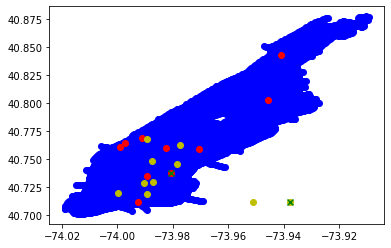

---------------------------
x   -73.992472
y    40.711763
Name: 9471, dtype: float64


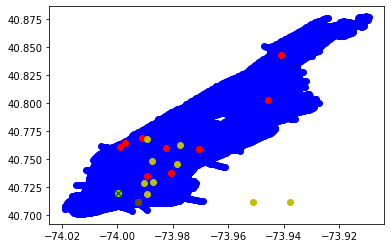

---------------------------
x   -73.989432
y    40.734671
Name: 11758, dtype: float64


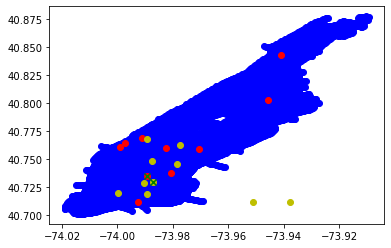

---------------------------
x   -73.980576
y    40.737955
Name: 2764, dtype: float64


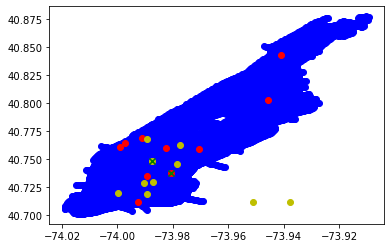

---------------------------
x   -73.980576
y    40.737955
Name: 2764, dtype: float64


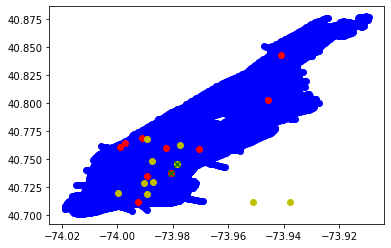

---------------------------
x   -73.982437
y    40.759979
Name: 7130, dtype: float64


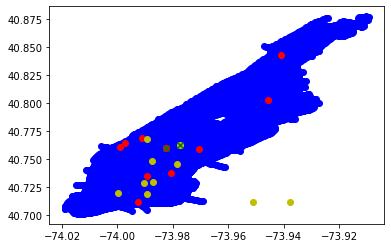

---------------------------
x   -73.991058
y    40.769237
Name: 8494, dtype: float64


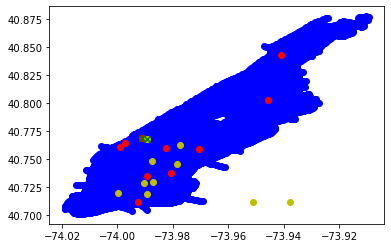

---------------------------
x   -73.980576
y    40.737955
Name: 2764, dtype: float64


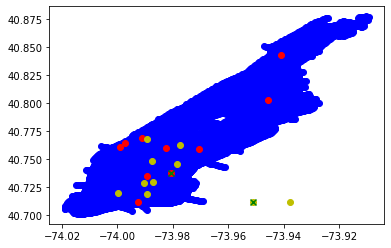

---------------------------
x   -73.992472
y    40.711763
Name: 9471, dtype: float64


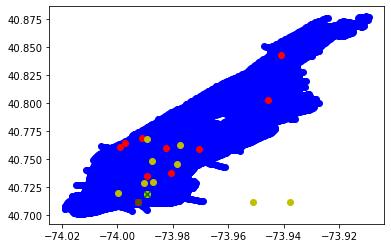

---------------------------
x   -73.989432
y    40.734671
Name: 11758, dtype: float64


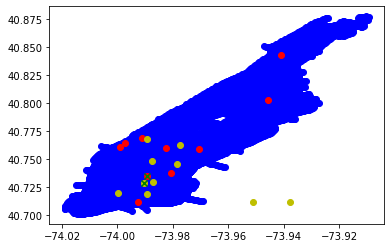

In [20]:
r=0
n_subset = nodes.sample(n=10,random_state=r)
r_subset = df.sample(n=10,random_state=r)

print(n_subset)
dm = distance_matrix(n_subset,r_subset[['pickup_longitude','pickup_latitude']])
print("distance matrix:")
print(dm)
print("shape:",dm.shape)
print("chosen nodes:")
chosen_indices=np.argmin(dm,axis=0)
for i in range(0,len(r_subset)):
    chosen_index=chosen_indices[i]
    print("---------------------------")
    plt.scatter(nodes.x,nodes.y,c='b')
    plt.scatter(n_subset.x,n_subset.y,c='r')
    plt.scatter(r_subset.pickup_longitude,r_subset.pickup_latitude,c='y')
    chosen=n_subset.iloc[chosen_index]
    print(chosen)
    plt.scatter(r_subset.iloc[i]['pickup_longitude'],r_subset.iloc[i]['pickup_latitude'],c='g',marker='x')
    plt.scatter(chosen[0],chosen[1],c='g',marker='x')
    plt.show()

## Using a custom haversine distance metric

               x          y
id                         
155   -73.997437  40.764522
9471  -73.992472  40.711763
7130  -73.982437  40.759979
11758 -73.989432  40.734671
10170 -73.945744  40.802913
6939  -73.970745  40.759177
9031  -73.999054  40.761115
2552  -73.941054  40.843240
8494  -73.991058  40.769237
2764  -73.980576  40.737955
distance matrix:
[[4.23651702 0.8715796  0.98122347 0.75767193 1.35446864 1.37368998
  0.55086658 3.34779944 1.03848716 0.84359759]
 [3.7717302  0.52337418 0.50728664 0.7740037  1.15671348 1.4191061
  1.08622014 2.85051058 0.26040592 0.35747782]
 [3.21346328 1.42236216 0.66047155 0.41427826 0.38547999 0.34168457
  0.51094299 2.34442318 0.91471408 0.80433217]
 [3.58864734 0.76825508 0.19363724 0.28976365 0.77951778 0.98167493
  0.63038846 2.67612083 0.30229355 0.1269495 ]
 [1.82623829 4.05559874 3.17642037 3.06596104 2.51803522 2.32685396
  3.09778204 1.78008564 3.40716401 3.38569141]
 [2.44501172 2.14104283 1.25783033 1.17366074 0.59936183 0.47635865
  1.3

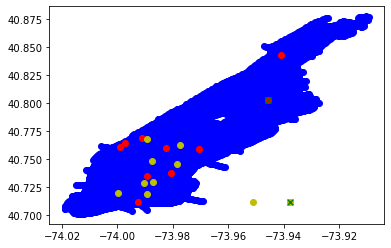

---------------------------
x   -73.992472
y    40.711763
Name: 9471, dtype: float64


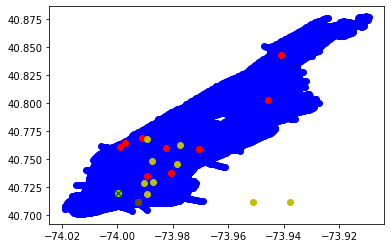

---------------------------
x   -73.989432
y    40.734671
Name: 11758, dtype: float64


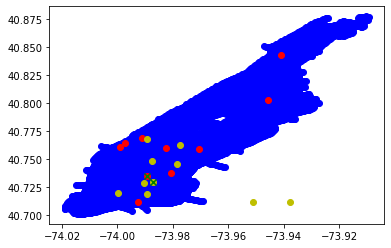

---------------------------
x   -73.989432
y    40.734671
Name: 11758, dtype: float64


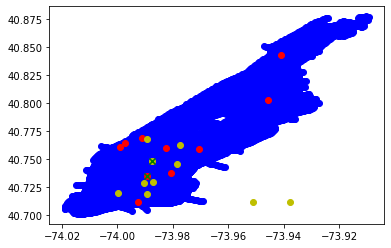

---------------------------
x   -73.980576
y    40.737955
Name: 2764, dtype: float64


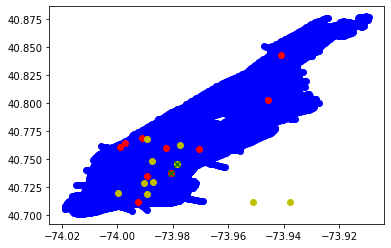

---------------------------
x   -73.982437
y    40.759979
Name: 7130, dtype: float64


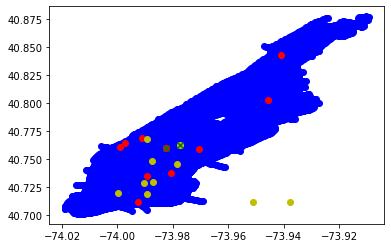

---------------------------
x   -73.991058
y    40.769237
Name: 8494, dtype: float64


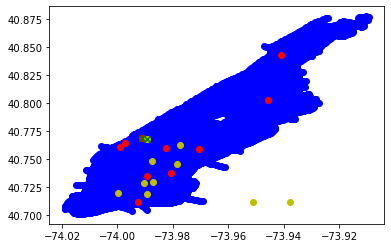

---------------------------
x   -73.970745
y    40.759177
Name: 6939, dtype: float64


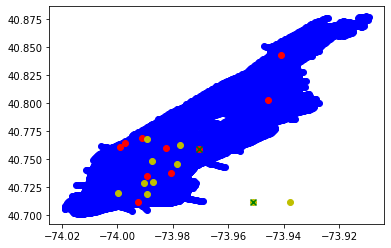

---------------------------
x   -73.992472
y    40.711763
Name: 9471, dtype: float64


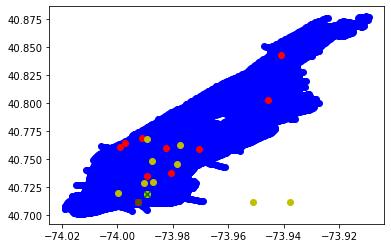

---------------------------
x   -73.989432
y    40.734671
Name: 11758, dtype: float64


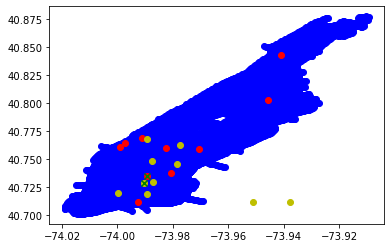

In [21]:
#following https://stackoverflow.com/a/19413731
r=0
n_subset = nodes.sample(n=10,random_state=r)
r_subset = df.sample(n=10,random_state=r)

def new_get_distances(loc1, loc2):
    earth_radius = 3958.75

    locs_1 = np.deg2rad(loc1)
    locs_2 = np.deg2rad(loc2)

    lat_dif = (locs_1[:,0][:,None]/2 - locs_2[:,0]/2)
    lon_dif = (locs_1[:,1][:,None]/2 - locs_2[:,1]/2)

    np.sin(lat_dif, out=lat_dif)
    np.sin(lon_dif, out=lon_dif)

    np.power(lat_dif, 2, out=lat_dif)
    np.power(lon_dif, 2, out=lon_dif)

    lon_dif *= ( np.cos(locs_1[:,0])[:,None] * np.cos(locs_2[:,0]) )
    lon_dif += lat_dif

    np.arctan2(np.power(lon_dif,.5), np.power(1-lon_dif,.5), out = lon_dif)
    lon_dif *= ( 2 * earth_radius )

    return lon_dif


print(n_subset)
locations_1=n_subset.to_numpy()
locations_2=r_subset[['pickup_longitude','pickup_latitude']].to_numpy()
dm = new_get_distances(locations_1,locations_2)
print("distance matrix:")
print(dm)
print("shape:",dm.shape)
print("chosen nodes:")
chosen_indices=np.argmin(dm,axis=0)
for i in range(0,len(r_subset)):
    chosen_index=chosen_indices[i]
    print("---------------------------")
    plt.scatter(nodes.x,nodes.y,c='b')
    plt.scatter(n_subset.x,n_subset.y,c='r')
    plt.scatter(r_subset.pickup_longitude,r_subset.pickup_latitude,c='y')
    chosen=n_subset.iloc[chosen_index]
    print(chosen)
    plt.scatter(r_subset.iloc[i]['pickup_longitude'],r_subset.iloc[i]['pickup_latitude'],c='g',marker='x')
    plt.scatter(chosen[0],chosen[1],c='g',marker='x')
    plt.show()

In [22]:
def vectorized_haversine(loc1, loc2):
    earth_radius = 3958.75

    locs_1 = np.deg2rad(loc1)
    locs_2 = np.deg2rad(loc2)

    lat_dif = (locs_1[:,0][:,None]/2 - locs_2[:,0]/2)
    lon_dif = (locs_1[:,1][:,None]/2 - locs_2[:,1]/2)

    np.sin(lat_dif, out=lat_dif)
    np.sin(lon_dif, out=lon_dif)

    np.power(lat_dif, 2, out=lat_dif)
    np.power(lon_dif, 2, out=lon_dif)

    lon_dif *= ( np.cos(locs_1[:,0])[:,None] * np.cos(locs_2[:,0]) )
    lon_dif += lat_dif

    np.arctan2(np.power(lon_dif,.5), np.power(1-lon_dif,.5), out = lon_dif)
    lon_dif *= ( 2 * earth_radius )

    return lon_dif

#calculating the distance matrix for the pickup points
nodes_array = nodes.to_numpy()
pickup_array = df[['pickup_longitude','pickup_latitude']].to_numpy()
pickup_dm = vectorized_haversine(nodes_array,pickup_array)
#finding the closest node and setting it as the pickup node
pickup_node_indices = np.argmin(pickup_dm,axis=0)
df['pickup_node']=np.array(nodes.iloc[pickup_node_indices].index)


#repeating the procedure to get the dropoff nodes
dropoff_array = df[['dropoff_longitude','dropoff_latitude']].to_numpy()
dropoff_dm = vectorized_haversine(nodes_array,dropoff_array)
#finding the closest node and setting it as the pickup node
dropoff_node_indices = np.argmin(dropoff_dm,axis=0)
df['dropoff_node']=np.array(nodes.iloc[dropoff_node_indices].index)
df

,rid,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_node,dropoff_node
0,74603,2013-05-05 03:00:00,6,-73.986803,40.729080,-74.003445,40.748627,3574,3465
1,74604,2013-05-05 03:00:00,1,-73.989812,40.756530,-73.942612,40.839952,2736,10688
2,74605,2013-05-05 03:00:00,1,-73.989222,40.721227,-74.014985,40.710017,245,9019
3,74606,2013-05-05 03:00:00,1,-73.998587,40.745212,-73.993222,40.721817,667,5186
4,74607,2013-05-05 03:00:00,1,-73.997562,40.725877,-73.994332,40.761072,7259,2292
...,...,...,...,...,...,...,...,...,...
15081,89684,2013-05-05 03:59:58,1,-74.001016,40.724222,-73.993514,40.721345,1852,5635
15082,89685,2013-05-05 03:59:59,1,-74.004167,40.750954,-73.949515,40.781691,11091,10741
15083,89686,2013-05-05 03:59:59,1,-73.973197,40.755355,-73.986771,40.760444,10198,1781
15084,89687,2013-05-05 03:59:59,1,-73.981780,40.743907,-73.991096,40.750610,3284,184


## Cleaning up some more invalid requests

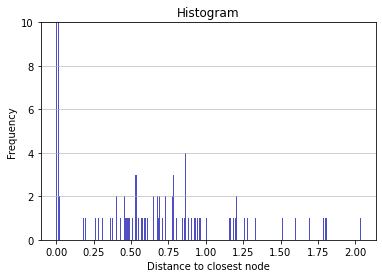

In [23]:
#nodes which are very far away from the closest point might be invalid (i.e. not even on the mainland)
dist_to_closest_node = np.min(pickup_dm,axis=0)

n, bins, patches = plt.hist(x=dist_to_closest_node, bins='auto', color='#0504aa',
                            alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Distance to closest node')
plt.ylabel('Frequency')
plt.title('Histogram')
maxfreq = dist_to_closest_node.max()
# Set a clean upper y-axis limit.
plt.ylim(ymax=np.ceil(maxfreq / 10) * 10 if maxfreq % 10 else maxfreq + 10)
plt.show()

In [24]:
df = df[(np.min(pickup_dm,axis=0)<1.0) & (np.min(dropoff_dm,axis=0)<1.0)]
df

,rid,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_node,dropoff_node
0,74603,2013-05-05 03:00:00,6,-73.986803,40.729080,-74.003445,40.748627,3574,3465
1,74604,2013-05-05 03:00:00,1,-73.989812,40.756530,-73.942612,40.839952,2736,10688
2,74605,2013-05-05 03:00:00,1,-73.989222,40.721227,-74.014985,40.710017,245,9019
3,74606,2013-05-05 03:00:00,1,-73.998587,40.745212,-73.993222,40.721817,667,5186
4,74607,2013-05-05 03:00:00,1,-73.997562,40.725877,-73.994332,40.761072,7259,2292
...,...,...,...,...,...,...,...,...,...
15081,89684,2013-05-05 03:59:58,1,-74.001016,40.724222,-73.993514,40.721345,1852,5635
15082,89685,2013-05-05 03:59:59,1,-74.004167,40.750954,-73.949515,40.781691,11091,10741
15083,89686,2013-05-05 03:59:59,1,-73.973197,40.755355,-73.986771,40.760444,10198,1781
15084,89687,2013-05-05 03:59:59,1,-73.981780,40.743907,-73.991096,40.750610,3284,184


In [25]:
#removing requests with the same pickup and dropoff point
df = df[df.pickup_node!=df.dropoff_node]
df

,rid,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_node,dropoff_node
0,74603,2013-05-05 03:00:00,6,-73.986803,40.729080,-74.003445,40.748627,3574,3465
1,74604,2013-05-05 03:00:00,1,-73.989812,40.756530,-73.942612,40.839952,2736,10688
2,74605,2013-05-05 03:00:00,1,-73.989222,40.721227,-74.014985,40.710017,245,9019
3,74606,2013-05-05 03:00:00,1,-73.998587,40.745212,-73.993222,40.721817,667,5186
4,74607,2013-05-05 03:00:00,1,-73.997562,40.725877,-73.994332,40.761072,7259,2292
...,...,...,...,...,...,...,...,...,...
15081,89684,2013-05-05 03:59:58,1,-74.001016,40.724222,-73.993514,40.721345,1852,5635
15082,89685,2013-05-05 03:59:59,1,-74.004167,40.750954,-73.949515,40.781691,11091,10741
15083,89686,2013-05-05 03:59:59,1,-73.973197,40.755355,-73.986771,40.760444,10198,1781
15084,89687,2013-05-05 03:59:59,1,-73.981780,40.743907,-73.991096,40.750610,3284,184


In [26]:
df = df[['pickup_datetime','passenger_count','pickup_node','dropoff_node']]
df

,pickup_datetime,passenger_count,pickup_node,dropoff_node
0,2013-05-05 03:00:00,6,3574,3465
1,2013-05-05 03:00:00,1,2736,10688
2,2013-05-05 03:00:00,1,245,9019
3,2013-05-05 03:00:00,1,667,5186
4,2013-05-05 03:00:00,1,7259,2292
...,...,...,...,...
15081,2013-05-05 03:59:58,1,1852,5635
15082,2013-05-05 03:59:59,1,11091,10741
15083,2013-05-05 03:59:59,1,10198,1781
15084,2013-05-05 03:59:59,1,3284,184


In [27]:
def process_file(input_path,output_path,dist_thresh):
    global nodes

    df = pd.read_csv(input_path)
    #calculating the distance matrix for the pickup points
    nodes_array = nodes.to_numpy()
    pickup_array = df[['pickup_longitude','pickup_latitude']].to_numpy()
    pickup_dm = vectorized_haversine(nodes_array,pickup_array)
    #finding the closest node and setting it as the pickup node
    pickup_node_indices = np.argmin(pickup_dm,axis=0)
    df['pickup_node']=np.array(nodes.iloc[pickup_node_indices].index)


    #repeating the procedure to get the dropoff nodes
    dropoff_array = df[['dropoff_longitude','dropoff_latitude']].to_numpy()
    dropoff_dm = vectorized_haversine(nodes_array,dropoff_array)
    #finding the closest node and setting it as the pickup node
    dropoff_node_indices = np.argmin(dropoff_dm,axis=0)
    df['dropoff_node']=np.array(nodes.iloc[dropoff_node_indices].index)

    #removing requests that are at least "dist_thresh" away from even the closest node
    df = df[(np.min(pickup_dm,axis=0)<dist_thresh) & (np.min(dropoff_dm,axis=0)<dist_thresh)]

    #removing requests with the same pickup and dropoff pointdf2['pickup_longitude'] = list(nodes.loc[df2['pickup_node']]['x'])
    df = df[df.pickup_node!=df.dropoff_node]
    
    df = df[['rid','pickup_datetime','passenger_count','pickup_node','dropoff_node']]
    df = df.sort_values(by='rid')
    df.to_csv(output_path,index=False)


In [28]:
out_dir="./filtered_nodeid/"
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

in_dir="./filtered_longlat/"

for filename in sorted(os.listdir(in_dir)):
    print("processing",filename)
    process_file(in_dir+filename,out_dir+filename,0.1)

processing may10_hour0.csv
processing may10_hour1.csv
processing may10_hour10.csv
processing may10_hour11.csv
processing may10_hour12.csv
processing may10_hour13.csv
processing may10_hour14.csv
processing may10_hour15.csv
processing may10_hour16.csv
processing may10_hour17.csv
processing may10_hour18.csv
processing may10_hour19.csv
processing may10_hour2.csv
processing may10_hour20.csv
processing may10_hour21.csv
processing may10_hour22.csv
processing may10_hour23.csv
processing may10_hour3.csv
processing may10_hour4.csv
processing may10_hour5.csv
processing may10_hour6.csv
processing may10_hour7.csv
processing may10_hour8.csv
processing may10_hour9.csv
processing may11_hour0.csv
processing may11_hour1.csv
processing may11_hour10.csv
processing may11_hour11.csv
processing may11_hour12.csv
processing may11_hour13.csv
processing may11_hour14.csv
processing may11_hour15.csv
processing may11_hour16.csv
processing may11_hour17.csv
processing may11_hour18.csv
processing may11_hour19.csv
proc

## Testing

to test the mapping of longitude/latitude to nodes, we plot a set of points with their actual pickup long/lat and the long/lat of their pickup node

In [29]:
#fetching a random set of requests
#we use the file with requests mapped onto nodes since some requests in the other file
#may have been removed
num_requests = 100
df2 = pd.read_csv('./filtered_nodeid/may5_hour0.csv').sample(n=num_requests)
df2 = df2.set_index('rid')
df2['pickup_longitude'] = list(nodes.loc[df2['pickup_node']]['x'])
df2['pickup_latitude'] = list(nodes.loc[df2['pickup_node']]['y'])
df2

,pickup_datetime,passenger_count,pickup_node,dropoff_node,pickup_longitude,pickup_latitude
rid,,,,,,
9919,2013-05-05 00:20:00,1,8162,6360,-73.978330,40.741991
10726,2013-05-05 00:21:22,1,5572,6527,-73.972877,40.760079
7604,2013-05-05 00:15:00,1,3908,7286,-73.998577,40.750384
15703,2013-05-05 00:32:00,2,9616,5412,-73.998385,40.719529
10633,2013-05-05 00:21:00,1,8847,5732,-73.989540,40.730694
...,...,...,...,...,...,...
27207,2013-05-05 00:56:44,2,8551,1040,-73.989218,40.759538
25815,2013-05-05 00:53:54,1,769,1542,-73.971372,40.751356
9090,2013-05-05 00:18:00,1,9507,10530,-73.984623,40.742142


In [30]:
df1 = pd.read_csv('./filtered_longlat/may5_hour0.csv').set_index('rid')
df1 = df1.loc[df2.index]
df1

,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
rid,,,,,,
9919,2013-05-05 00:20:00,1,-73.978232,40.741692,-73.977658,40.725697
10726,2013-05-05 00:21:22,1,-73.973018,40.759980,-73.983933,40.765070
7604,2013-05-05 00:15:00,1,-73.998565,40.750372,-73.997987,40.755800
15703,2013-05-05 00:32:00,2,-73.998407,40.719702,-73.991797,40.715262
10633,2013-05-05 00:21:00,1,-73.989422,40.731187,-73.973602,40.752945
...,...,...,...,...,...,...
27207,2013-05-05 00:56:44,2,-73.989309,40.759538,-74.003572,40.733635
25815,2013-05-05 00:53:54,1,-73.971160,40.751560,-73.946299,40.772916
9090,2013-05-05 00:18:00,1,-73.984815,40.741897,-73.987190,40.714405


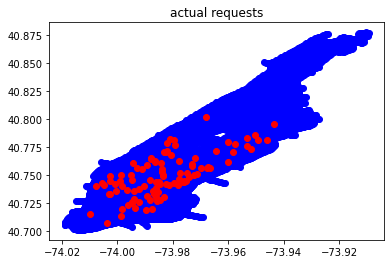

In [31]:
plt.scatter(nodes.x,nodes.y,c='b')
plt.scatter(df1['pickup_longitude'],df1['pickup_latitude'],c='r')
plt.xlim=(west,east)
plt.ylim=(south,north)
plt.title('actual requests')
plt.show()

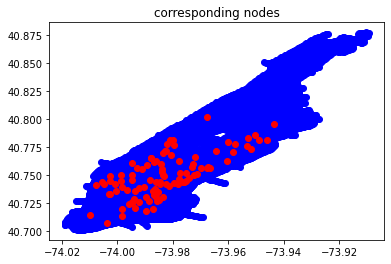

In [32]:
plt.scatter(nodes.x,nodes.y,c='b')
plt.scatter(df2['pickup_longitude'],df2['pickup_latitude'],c='r')
plt.title('corresponding nodes')
plt.xlim=(west,east)
plt.ylim=(south,north)
plt.show()